In [1]:
using LinearAlgebra, Plots, Printf, SparseArrays, IterativeSolvers, LaTeXStrings

# Crank-Nicolson in 2D

In this notebook we will develop numerical methods to solve

\begin{align*} \begin{cases} u_t(x,y,t) = u_{xx}(x,y,t) + u_{yy}(x,y,t)\\
u(x,y,0) = \eta(x,y),\\
u(0,y,t) = h_0(y,t),\\
u(1,y,t) = h_1(y,t),\\
u(x,0,t) = g_0(x,t),\\
u(x,1,t) = g_1(x,t). \end{cases} \end{align*}

Using the method of lines, we obtain for $1 \leq i,j \leq m$, $h = 1/(m+1)$,

\begin{align*}
    U'_{i,j}(t) = \frac{ U_{i-1,j}(t) + U_{i+1,j}(t) + U_{i,j-1}(t) + U_{i,j+1}(t) - 4 U_{i,j}(t)}{h^2}.
\end{align*}






We know from our use of Kronecker products, we can write this system as

$$ U'(t) = A U(t) + U(t) A + F(t), \quad U(t) = \begin{bmatrix} \phantom{\frac 1 1} \\U_{i,j}(t)  \\\phantom{\frac 1 1} \end{bmatrix}.$$

where $F(t)$ is used to enforce the boundary conditions.

In [19]:
bcfun = (x,y,t) -> t/(1 + t)*exp.(x.*y)*(sin(10*t)^2).+0.3
h0 = (y,t) -> bcfun(0.0,y,t)
h1 = (y,t) -> bcfun(1.0,y,t)
g0 = (x,t) -> bcfun(x,0.0,t)
g1 = (x,t) -> bcfun(x,1.0,t)
η = (x,y) -> 2*y.*x.*exp.(-30*(2*(x .- 0.5).^2 .+ (y .- 0.5).^2)).+0.3

#142 (generic function with 1 method)

In [20]:
m = 99
h = 1/(m + 1)
x = Array(h:h:1-h)
y = x
X = repeat(reshape(x, 1, :), length(y), 1)
Y = repeat(reverse(y), 1, length(x));

e1 = zeros(m); e1[1] = 1.0;
em = zeros(m); em[end] = 1.0;

A = 1/h^2*SymTridiagonal(fill(-2.0,m),fill(1.0,m-1));

function F(t) # not the most efficient way to do this...
    out = h^(-2)*map(x -> h1(x,t),y |> reverse)*em' |> sparse
    out +=  h^(-2)*map(x -> h0(x,t),y |> reverse)*e1' |> sparse
    out += h^(-2)*em*map(x -> g0(x,t),x)' |> sparse
    out += h^(-2)*e1*map(x -> g1(x,t),x)' |> sparse
    out
end

isqrt = m ->  convert(Int64, sqrt(m) |> floor)
# vec is already defined by LinearAlgebra
mat = x -> reshape(x, (isqrt(length(x)),isqrt(length(x))))

#154 (generic function with 1 method)

Applying the trapezoid method to this we obtain a 2D Crank-Nicolson-type method.  If we use forward Euler we obtain (clearly) an explicit method.  The von Neumann stability analysis indicated that this explicit method is stable if

\begin{align*}
    \frac{k}{h^2} \leq \frac{1}{4}.
\end{align*}

We will confirm this to be the case.

In [21]:
bcfun = (x,y,t) -> t/(1 + t)*exp.(x.*y)*(sin(10*t)^2).+0.3
h0 = (y,t) -> bcfun(0.0,y,t)
h1 = (y,t) -> bcfun(1.0,y,t)
g0 = (x,t) -> bcfun(x,0.0,t)
g1 = (x,t) -> bcfun(x,1.0,t)
η = (x,y) -> 2*y.*x.*exp.(-30*(2*(x .- 0.5).^2 .+ (y .- 0.5).^2)).+0.3

function plot_heat(U,x,y,t,cl,width=800)
    p1 = surface(x, y, U[end:-1:1,:], zaxis = [cl[1],cl[2]], xaxis = [0,1], yaxis = [0,1], clims= cl, aspectratio = 1.3, xlabel = L"x", ylabel = L"y", zlabel = L"u(x,y,t)")
    p2 = contour(x, y, U[end:-1:1,:], clims=cl, xaxis = [0,1], yaxis = [0,1], fill = true, aspectratio = 1, xlabel = L"x", ylabel = L"y")
    plot(p1, p2, layout = 2, size = (width, 7*width/10), title = @sprintf("t = %1.4f",t))
end

plot_heat (generic function with 2 methods)

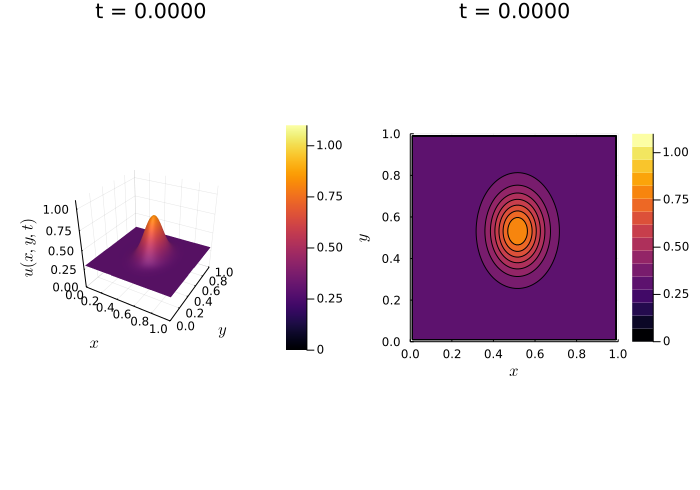

In [22]:
U⁰ = η(X,Y)
plot_heat(U⁰,x,y,0.0,(0.0,1.1),700)

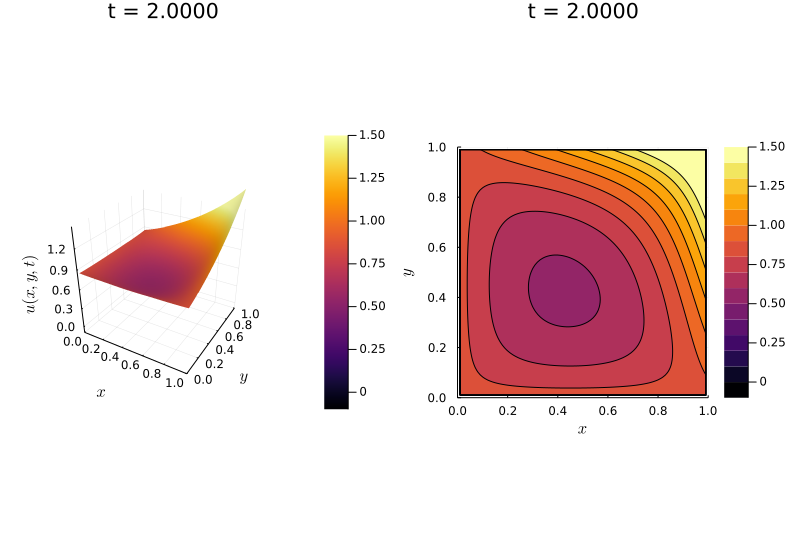

In [23]:
h = .01; k = h^2/4; T = 2;  #On the stability boundary
m = convert(Int64,1/h)-1;
n = convert(Int64,ceil(T/k))

x = Array(h:h:1-h)
y = x
X = repeat(reshape(x, 1, :), length(y), 1)
Y = repeat(reverse(y), 1, length(x))

e1 = zeros(m); e1[1] = 1.0;
em = zeros(m); em[end] = 1.0;

r = k/h^2
A = r*SymTridiagonal(fill(-2.0,m),fill(1.0,m-1));
A = kron(sparse(I,m,m),A |> sparse) + kron(A |> sparse,sparse(I,m,m))

function F(t) # not the most efficient way to do this...
    out = r*map(y -> h1(y,t),y |> reverse)*em' |> sparse
    out +=  r*map(y -> h0(y,t),y |> reverse)*e1' |> sparse
    out += r*em*map(x -> g0(x,t),x)' |> sparse
    out += r*e1*map(x -> g1(x,t),x)' |> sparse
    out |> vec
end

U⁰ = η(X,Y)
U = copy(U⁰) |> vec
t = 0
fr = 100 #frames/unit time
tb = convert(Int64,ceil(n/(fr*T)))
for i = 2:n+1
    t += k
    U += A*U
    U += F(t-k)
    if mod(i-1,tb) ≈ 0.0
        IJulia.clear_output(true)
        plot_heat(mat(U),x,y,t,(-0.1,1.5)) |> IJulia.display
    end
end

In [7]:
h = .01; k = h^2/4*(1.001); T = .66;  #Just beyond the stability boundary
m = convert(Int64,1/h)-1;
n = convert(Int64,ceil(T/k))

x = Array(h:h:1-h)
y = x
X = repeat(reshape(x, 1, :), length(y), 1)
Y = repeat(reverse(y), 1, length(x))

e1 = zeros(m); e1[1] = 1.0;
em = zeros(m); em[end] = 1.0;

r = k/h^2
A = r*SymTridiagonal(fill(-2.0,m),fill(1.0,m-1));
A = kron(sparse(I,m,m),A |> sparse) + kron(A |> sparse,sparse(I,m,m))

function F(t) # not the most efficient way to do this...
    out = r*map(x -> h1(x,t),y |> reverse)*em' |> sparse
    out +=  r*map(x -> h0(x,t),y |> reverse)*e1' |> sparse
    out += r*em*map(y -> g0(y,t),x)' |> sparse
    out += r*e1*map(y -> g1(y,t),x)' |> sparse
    out |> vec
end

U⁰ = η(X,Y)
U = copy(U⁰) |> vec
t = 0
fr = 100 #frames/unit time
tb = convert(Int64,ceil(n/(fr*T)))
for i = 2:n+1
    t += k
    U += A*U
    U += F(t)
    if mod(i-1,tb) ≈ 0.0
        IJulia.clear_output(true)
        plot_heat(mat(U),x,y,t,(-0.1,1.5)) |> IJulia.display
    end
end

Use the Sylvester form

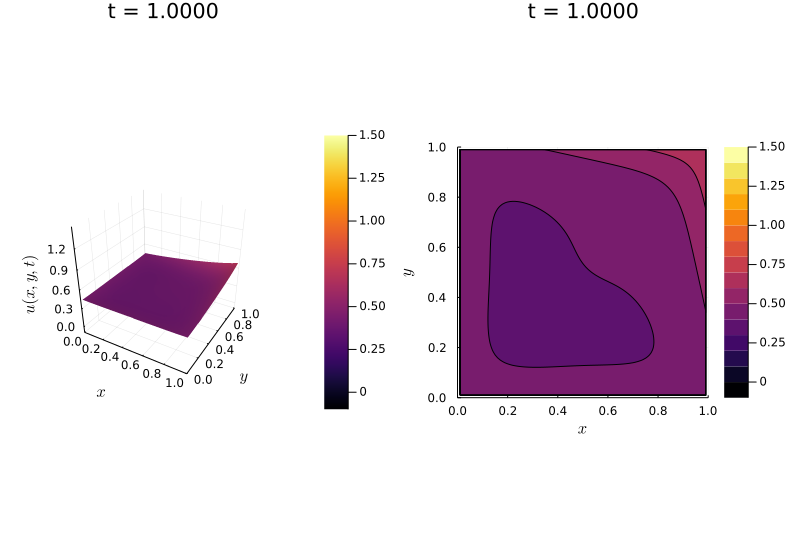

In [24]:
h = .01; k = h^2/4; T = 1;  #On the stability boundary
m = convert(Int64,1/h)-1;
n = convert(Int64,ceil(T/k))

x = Array(h:h:1-h)
y = x
X = repeat(reshape(x, 1, :), length(y), 1)
Y = repeat(reverse(y), 1, length(x))

e1 = zeros(m); e1[1] = 1.0;
em = zeros(m); em[end] = 1.0;

r = k/h^2
A = r*SymTridiagonal(fill(-2.0,m),fill(1.0,m-1));

function F(t) # not the most efficient way to do this...
    out = r*map(x -> h1(x,t),y |> reverse)*em' |> sparse
    out +=  r*map(x -> h0(x,t),y |> reverse)*e1' |> sparse
    out += r*em*map(x -> g0(x,t),x)' |> sparse
    out += r*e1*map(x -> g1(x,t),x)' |> sparse
    out
end

U⁰ = η(X,Y)
U = copy(U⁰)
t = 0
fr = 100 #frames/unit time
tb = convert(Int64,ceil(n/(fr*T)))
for i = 2:n+1
    t += k
    U += A*U + U*A
    U += F(t-k)
    if mod(i-1,tb) ≈ 0.0
        IJulia.clear_output(true)
        plot_heat(U,x,y,t,(-0.1,1.5)) |> IJulia.display
    end
end

## A different version

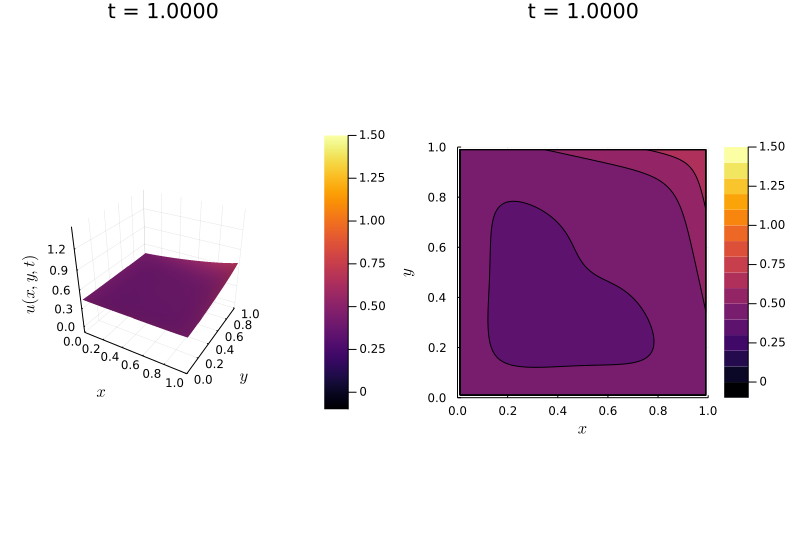

In [25]:
h = .01; k = h^2/2; T = 1;  #On the stability boundary
m = convert(Int64,1/h)-1;
n = convert(Int64,ceil(T/k))

x = Array(h:h:1-h)
y = x
X = repeat(reshape(x, 1, :), length(y), 1)
Y = repeat(reverse(y), 1, length(x))

e1 = zeros(m); e1[1] = 1.0;
em = zeros(m); em[end] = 1.0;

r = k/h^2
A = r*SymTridiagonal(fill(-2.0,m),fill(1.0,m-1));

function F1(t) # not the most efficient way to do this...
    out = r*map(y -> h1(y,t),y |> reverse)*em' |> sparse
    out +=  r*map(y -> h0(y,t),y |> reverse)*e1' |> sparse
    out
end

function F2(t)
    out = r*em*map(x -> g0(x,t),x)' |> sparse
    out += r*e1*map(x -> g1(x,t),x)' |> sparse
    out
end

U⁰ = η(X,Y)
U = copy(U⁰)
t = 0
fr = 100 #frames/unit time
tb = convert(Int64,ceil(n/(fr*T)))
for i = 2:n+1
    t += k
    U += A*U
    U += F2(t-k)
    U += U*A
    U += F1(t-k)
    if mod(i-1,tb) ≈ 0.0
        IJulia.clear_output(true)
        plot_heat(U,x,y,t,(-0.1,1.5)) |> IJulia.display
    end
end

### Locally one-dimensional method with Crank-Nicolson

In [32]:
bcfun = (x,y,t) -> exp.(x.*y)
h0 = (y,t) -> bcfun(0.0,y,t)
h1 = (y,t) -> bcfun(1.0,y,t)
g0 = (x,t) -> bcfun(x,0.0,t)
g1 = (x,t) -> bcfun(x,1.0,t)
η = (x,y) -> 2*y.*x.*exp.(-30*(2*(x .- 0.5).^2 .+ (y .- 0.5).^2)).+0.3

#241 (generic function with 1 method)

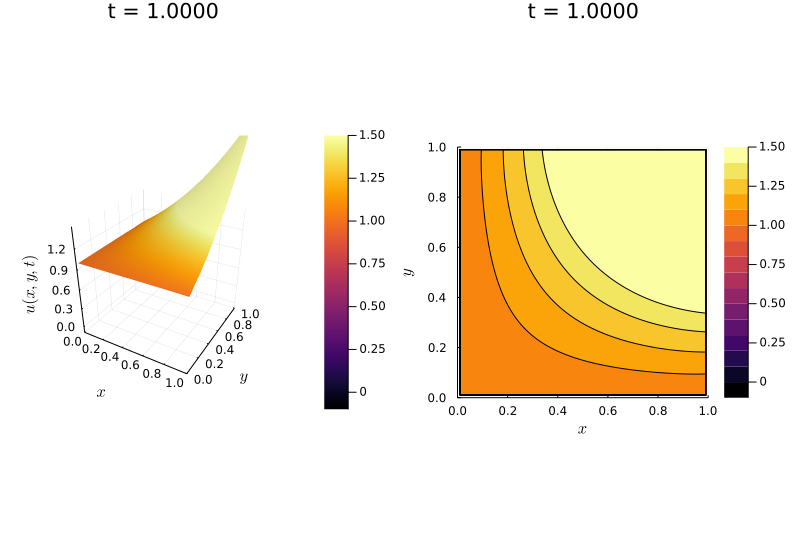

In [33]:
h = .01; k = h^2/2; T = 1;  #On the stability boundary
m = convert(Int64,1/h)-1;
n = convert(Int64,ceil(T/k))

x = Array(h:h:1-h)
y = x
X = repeat(reshape(x, 1, :), length(y), 1)
Y = repeat(reverse(y), 1, length(x))

e1 = zeros(m); e1[1] = 1.0;
em = zeros(m); em[end] = 1.0;

r = k/(2h^2)
A = r*SymTridiagonal(fill(-2.0,m),fill(1.0,m-1));
Al = I - A
Ar = I + A

function F1(t) # not the most efficient way to do this...
    out = r*map(y -> h1(y,t),y |> reverse)*em' |> sparse
    out += r*map(y -> h0(y,t),y |> reverse)*e1' |> sparse
    out
end

function F2(t)
    out = r*em*map(x -> g0(x,t),x)' |> sparse
    out += r*e1*map(x -> g1(x,t),x)' |> sparse
    out
end

U⁰ = η(X,Y)
U = copy(U⁰)
t = 0
fr = 100 #frames/unit time
tb = convert(Int64,ceil(n/(fr*T)))
for i = 2:n+1
    t += k
    U = Al\(Ar*U + F2(t-k) + F2(t))
    U = (Al\(U*Ar + F1(t-k) + F1(t))')'
    if mod(i-1,tb) ≈ 0.0
        IJulia.clear_output(true)
        plot_heat(U,x,y,t,(-0.1,1.5)) |> IJulia.display
    end
end

### A new Laplace solver

In [34]:
bcfun = (x,y,t) -> exp.(x.*y)
h0 = (y,t) -> bcfun(0.0,y,t)
h1 = (y,t) -> bcfun(1.0,y,t)
g0 = (x,t) -> bcfun(x,0.0,t)
g1 = (x,t) -> bcfun(x,1.0,t)
η = (x,y) -> 2*y.*x.*exp.(-30*(2*(x .- 0.5).^2 .+ (y .- 0.5).^2)).+0.3

#261 (generic function with 1 method)

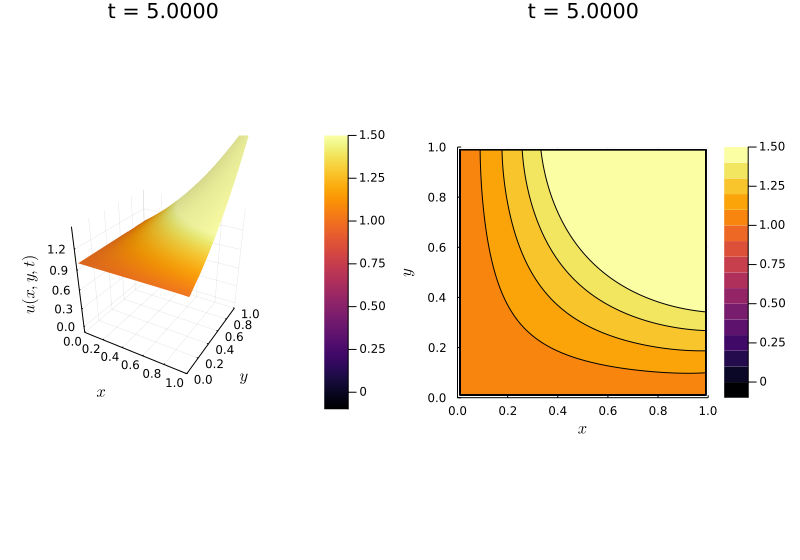

In [37]:
h = .01; k = .01; T = 5;  #On the stability boundary
m = convert(Int64,1/h)-1;
n = convert(Int64,ceil(T/k))

x = Array(h:h:1-h)
y = x
X = repeat(reshape(x, 1, :), length(y), 1)
Y = repeat(reverse(y), 1, length(x))

r = k/(2h^2)
A = r*SymTridiagonal(fill(-2.0,m),fill(1.0,m-1));

e1 = zeros(m); e1[1] = r;
em = zeros(m); em[end] = r;
Al = I - A
Ar = I + A

function F1(t) # not the most efficient way to do this...
    out = map(y -> h1(y,t),y |> reverse)*em' |> sparse
    out +=  map(y -> h0(y,t),y |> reverse)*e1' |> sparse
    out
end

function F2(t)
    out = em*map(x -> g0(x,t),x)' |> sparse
    out += e1*map(x -> g1(x,t),x)' |> sparse
    out
end

U⁰ = η(X,Y)
U = copy(U⁰)
t = 0
fr = 100 #frames/unit time
tb = convert(Int64,ceil(n/(fr*T)))
for i = 2:n+1
    t += k
    U = Al\(Ar*U + F2(t-k) + F2(t))
    U = (Al\(U*Ar + F1(t-k) + F1(t))')'
    if mod(i-1,tb) ≈ 0.0
        IJulia.clear_output(true)
        plot_heat(U,x,y,t,(-0.1,1.5)) |> IJulia.display
    end
end

In [38]:
FF = U -> A*U + U*A
b = F1(0.0) + F2(0.0)
function ⋄(X,Y)
    h^2*dot(X,Y)
end

function CG(f,b,⋄,eps::Float64;kmax = 1e6, resflag = false)
   x = 0.0*b; r = b; p = r; n = 0;
   for j = 1:kmax
        n = j
        q = f(p)
        a = (r⋄r)/(p⋄q)
        x = x + a*p
        r_old = r
        r = r - a*q
        if resflag
            println(sqrt(r⋄r))
        end
        if sqrt(r⋄r) < eps
            break
        end
        b = (r⋄r)/(r_old⋄r_old)
        p = r + b*p
        
    end
    @printf("CG took %i iterations",n)
    x
end

CG (generic function with 1 method)

CG took 224 iterations

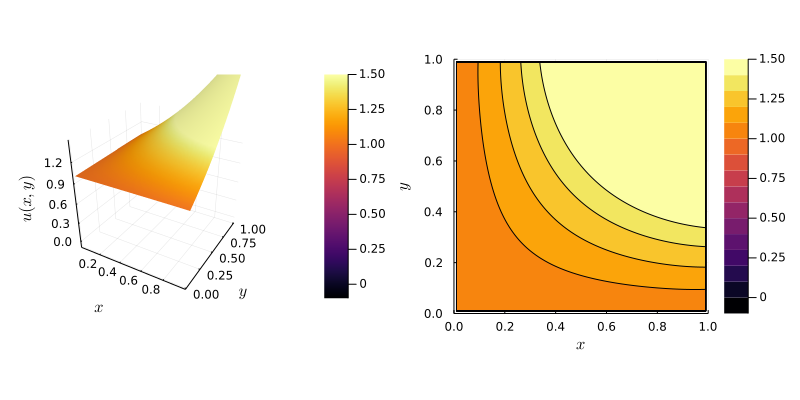

In [39]:
U = CG(FF,-b,⋄,h^2; resflag = false)
cl = (-.1,1.5);
width = 800
p1 = surface(x, y, U[end:-1:1,:], zaxis = [cl[1],cl[2]], clims= cl, aspectratio = 1, xlabel = L"x", ylabel = L"y", zlabel = L"u(x,y)")
p2 = contour(x, y, U[end:-1:1,:], clims=cl, xaxis = [0,1], yaxis = [0,1], fill = true, aspectratio = 1, xlabel = L"x", ylabel = L"y")
plot(p1, p2, layout = 2, size = (width, .5width))